#NN PROJECT
In this Colab we are going to show how we implemented the methods proposed in the paper [Zero-Shot Image Restoration Using Denoising Diffusion Null-Space Model](https://arxiv.org/pdf/2212.00490.pdf) (Wang et al., 2022) [1].

To read more comfortably and in detail check also our report in pdf: [link](https://github.com/andreamazzitelli/ProjectNN/blob/main/report.pdf).

# INTRODUCTION
This section contains a description of the methods we have implemented, both from the paper perspective and from our point of view.

##Paper description
The paper introduces a new zero-shot approach to solve Image Restoration (IR) tasks starting from a pretrained model. The authors propose a sampling algorithm called DDNM and an enhanced version DDNM+.
To properly understand these new methods, a small background is needed on the following topics:
- the state-of-the-art diffusion model presented in *Denoising Diffusion Probabilistic Model* (DDPM) (Ho et al., 2020) [2]. Indeed, DDPM is the starting point for the improvements in the paper we are working on. It also provides the definitions of the probability distributions $q$ and $p$;
- Range-Null Space Decomposition: any sample $x$ can be decomposed into its range-space and null-space as follows $x \equiv A^\dagger Ax+(I - A^\dagger A)x$. Moreover, some useful properties hold over the components of this decomposition, for example: $AA^\dagger Ax \equiv Ax$ and $A(I-A^\dagger A)x\equiv 0$.

After giving us this initial background, the paper starts by explaining the basic method considering the simple case of noise-free IR. This initial problem can be described as $y = Ax$ where $y$ is the degraded image, $A$ is the degradation operator and $x$ is the ground-truth (GT) image. Therefore, given $y$, the proposed methods aim to produce a *x̂* that satisfies the constraints of *Consistency* ($A$*x̂* $\equiv y$) and *Realness* (*x̂* $\sim q(x)$).

At this point, the paper explains how to meet these constraints.
The *Consistency* constraint is met thanks to the range-null space decomposition. Indeed, if we consider $Ax=y$ and decompose the GT image $x$, we obtain $Ax \equiv AA^\dagger Ax + A(I-A^\dagger A)x \equiv Ax + 0 = y$. But this means that starting from a degraded image $y$ we can obtain a general solution *x̂* $= A^\dagger y + (I - A^\dagger A)\bar{x}$ that satisfies the *Consistency* constraint whatever value is assigned to $\bar{x}$. Indeed

$A$*x̂* $\equiv A(A^\dagger y + A(I-A^\dagger A)\bar{x}) \equiv AA^\dagger y + A(I - A^\dagger A)\bar{x} \equiv AA^\dagger y = AA^\dagger A$*x̂* $\equiv A$*x̂* $= y$

It is possible to see that $\bar{x}$ does not affect *Consistency* but influences the *Realness* *x̂* $\sim q(x)$.

Now, the goal is to find a $\bar{x}$ such that *Realness* is met; this is done using the diffusion model to predict the noise and iteratively clean the degraded image and refine $\bar{x}$ to obtain better results. The resulting sampling algorithm is *Algorithm 1* in the discussed paper [1].

This first approach works, but is limited due to the assumption of noise-free tasks, so the authors propose an enhanced version called DDNM+ that copes with additional noise. Consider a general noisy IR problem described as $y = Ax + n$ where $y, A$ and $x$ have the same meaning as before and $n\sim N(0, \sigma_y^2 I)$ is Gaussian noise.

Instead of providing an implementation, the paper introduces the Time-Travel Trick as an additional building block to obtain a better *Realness*. The trick consists of reversing $l$ steps at each time step $t$. In this way, we travel back in time to create a better 'past' knowing the 'present' and this yields to a better 'future'.

At this point DDNM+ and the time travel trick are combined to obtain *Algorithm 2* most general version of the method presented in the paper [1].

Using any version of DDNM the paper also introduces the Mask-Shift Trick that allows to solve IR task of arbitrary dimensions. This is done by dividing the degraded image into patches that are then passed in pairs as input to the algorithm.

The algorithm presented is Zero Shot because it can perform any IR task without needing a model explicitly trained for the task. Only matrix A must be chosen according to the task to be performed.

##Our approach
After reading the paper, we decided to implement the sampling process described by Ho et al. (2020) [2] even if only mentioned by Wang et al. (2022)[1]. In this way, we would better understand the inner workings of a state-of-the-art diffusion model, giving us a good starting point from which to understand how we should implement the algorithm proposed by our chosen paper [1] (the implementation can be seen under Appendix A).

Once the DDPM sampling was implemented, we moved to implement the algorithms presented by Wang et al.(2022) [1] starting from standard DDNM.
Following the original implementation of DDPM [2] we set $T = 1000$, $\beta_t$ as linearly increasing constants between $0.0001$ and $0.02$ and following the reparameterization trick from Kingma et al. (2014) [3] we defined $\alpha_t = 1 - \beta_t$ and $\overline{\alpha}_t = \prod_{i=0}^{t}\alpha_i$. So, we start iterating from $t= 1000$ to $t=1$ and at each time step $t$ we compute the estimate of the final output $x_0$ defined as
\begin{equation}
    x_{0|t} = \frac{1}{\sqrt{\bar{\alpha}_t}}(x_t - Z_{\theta}(x_t, t)\sqrt{1-\bar{\alpha}_t})
\end{equation}
where $Z_{\theta}$ is a denoising diffusion model. In our implementation, we used two models pre-trained on ImageNet and CelebA.
Then, we computed a rectified estimation in which we fix the range-space and leave untouched the null-space 
\begin{equation}
    \hat{x}_{0|t} = A^\dagger y + (I - A^\dagger A)x_{0|t} = x_{0|t} - A^\dagger (Ax_{0|t} - y)
\end{equation}
Because $\hat{x}_{0|t}$ estimates $x_0$, we use it to sample $x_{t-1}$ from $p(x_{t-1}|x_t, \hat{x}_{0|t})$ with the values of $\mu_t(x_t, x_0)$ and $\sigma_t^2$ defined in the article.
\begin{equation}
    x_{t-1} = \mu_t(x_t, x_0)\hat{x}_{0|t} + \sigma_t\epsilon = \frac{\sqrt{\bar{\alpha}_{t-1}}\beta_t}{1 - \bar{\alpha}_t}\hat{x}_{0|t} + \frac{\sqrt{\alpha_t}(1 - \bar{\alpha}_{t-1})}{1 - \bar{\alpha}_t}x_t + \sigma_t\epsilon
\end{equation}
with $\epsilon\sim N(0, I)$. At each step, the noise we add reduces the disharmony between the range-space and null-space resulting in a final output $x_0\sim q(x)$.

At this point, using the code snippets provided in the paper [1] to implement $A$ and $A^\dagger$, we tested our implementation on the three main IR tasks, obtaining as expected results that are lacking in *Realness*.

Moving to the next algorithm, we decided to implement an intermediate version in which there is only the handling of noisy IR and not the time travel trick.
The implementation was straightforward, we simply needed to introduce $\Sigma_t$ and $\Phi_t$ to, respectively, scale the range-space correction and the added noise. In practice, this meant changing the above-mentioned equation into:
\begin{equation}
    \hat{x}_{0|t} = x_{0|t} - \Sigma_tA^\dagger (Ax_{0|t} - y)
\end{equation}

\begin{equation}
    x_{t-1} = \frac{\sqrt{\bar{\alpha}_{t-1}}\beta_t}{1 - \bar{\alpha}_t}\hat{x}_{0|t} + \frac{\sqrt{\alpha_t}(1 - \bar{\alpha}_{t-1})}{1 - \bar{\alpha}_t}x_t + \sqrt{\Phi_t}\epsilon
\end{equation}

Because we are still considering a simple case where the extra noise is approximated to a Gaussian, we can approximate $\Sigma_t$ and $\Phi_t$ using $\gamma_t$ and $\sigma_t$ that are defined in Eq.19 of the discussed paper [1].
In these equations, the value $\sigma_y$ is quite relevant because it represents the amount of noise present in the image.

To implement in code $\Sigma_t$ and $\Phi_t$, we used a part of a given snippet of code.

Once this first version of DDNM+ was implemented, we performed several experiments testing not only the usual IR tasks, but also the denoising capability of the method by trying different values of $\sigma_y$.

After completing the experiments, we proceeded to implement DDNM + with Time-Travel following the pseudocode shown in *Algorithm 2* of the paper [1].
Particular care was needed in "translating" $x_{t+L}\sim q(x_{t+L}|x_t)$ that allows us to compute a new value of the 'past' considering a value from the 'present'.

Considering that the forward process from which we are sampling is defined as a Markov chain, we could write $q(x_{t+L}|x_t) = \prod_{i = t}^{t+L-1}q(x_{i+1}|x_i)$. Moreover considering the reparameterization trick we have:
\begin{equation}
    q(x_{t+L}|x_t) = N(x_{t+L}; \sqrt{\frac{\bar{\alpha}_{t+L}}{\bar{\alpha}_t}}x_t; (1 - \frac{\bar{\alpha}_{t+L}}{\bar{\alpha}_t})I)
\end{equation}
and this means that the sample $x_{t+L}$ is 
\begin{equation}
    x_{t+L} = \mu_tx_t + \sigma_t\epsilon = \sqrt{\frac{\bar{\alpha}_{t+L}}{\bar{\alpha}_t}}x_t + \sqrt{1 - \frac{\bar{\alpha}_{t+L}}{\bar{\alpha}_t}}\epsilon
\end{equation}
In this way, "the time-travel trick produces a better 'past', which in turn produces a better 'future'" [1].

Starting from this new past, we recompute all the steps, using basic DDNM+, until we get back to our starting point.

Furthermore, because the paper very briefly mentioned $s$ as a hyper parameter that controls the interval of using the time travel trick, we also implemented it.

Now that we have all the implementations of DDNM, we performed experiments similar to those shown in the paper.

In conclusion, we also implemented the Mask-Shift trick (the code can be seen in Appendix B).

#CODE
This section includes the code implementing the method described in the paper and the instructions to run it.

It also includes the following appendices:
- A: Test generator
- B: Mask-shift trick implementation
- C: Useful code for evaluation
- D: Utilities to save images


##General Instructions:
If the colab is being executed for the first time:
- choose the parameters in the form and lauch that cell
- run all the cells up to Algorithm implementation
- choose the algorithm to use and run the corresponding cell in the Execution block
- wait for the results that will be shown compared to the input image

If you already run any algorithm and want to run again with some changes in the parametes:
- change the parameters (the cell should run automatically)
- if the changes on the parameters involved in some capacity the image or the mask (for example: changed image, added/removed the mask), run again the cell with header "Image and Mask Setup"
- choose the algorithm to use and run the corresponding cell in the Execution block
- wait for the results that will be shown compared to the input image

If you want to change the model (ImageNet or CelebA):
- change the parameters (the cell should run automatically)
- run again the cell with header "Model Setup"
- choose the algorithm to use and run the corresponding cell in the Execution block
- wait for the results that will be shown compared to the input image

###*Remember to connect to a Colab runtime with GPU*

Run the following cell to connect to your google drive only if you want to use custom images or masks:

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Set parameters

In [1]:
#@title {run:"auto"}

#@markdown ###Select the Pretrained Model to use:
#@markdown Celeba model is faster and works better with faces, Imagenet model is slower but works well with general images.
model_name = 'celeba' #@param["imagenet", "celeba"]

#@markdown ---
#@markdown ###Choose the Image and Mask
#@markdown Select one of the predefined images/masks or insert your own
#@markdown (if you are providing a custom image, it must be placed in the root folder of your google drive and the name in the field must be without '.png')

image_name = 'woman' #@param["balloons", "lion", "photographer", "woman", "lemons"] {allow-input: true}

#mask must be placed in drive, insert name without '.png'
mask_name = 'woman_eyes' #@param["woman_eyes", "woman_mouth", "lion_mouth", "lemons_mask"]{allow-input: true}

#@markdown ---

#@markdown ##Custom Mask
#@markdown By checking the generate_mask checkbox is possible to dynamically specify the position of a rectangular mask on the image by changing the values of x and y start and end positions.
#True if you need to generate the mask
generate_mask = False #@param {type:"boolean"}

#@markdown The minimum value allowed for the start is 0 and the maximum value allowed for the end is 256

mask_x_start = 150 #@param {type:"integer"}
mask_x_end = 220 #@param {type:"integer"}
mask_y_start = 75 #@param {type:"integer"}
mask_y_end = 160 #@param {type:"integer"}

#@markdown ---

#@markdown ##Select Modifier to Apply to your Image

#@markdown Check if you want to make the image black and white
make_gray_image = True #@param {type:"boolean"}

#@markdown Check if you want to reduce the input image resolution
reduce_image = True #@param {type:"boolean"} 

#@markdown Check if you want to add the mask to the input image
add_mask = True #@param {type:"boolean"}


#@markdown ---

#@markdown ##Reproducibility
#@markdown Choose a value for the seed for reproducibility purposes
manual_seed = True #@param {type:"boolean"}
seed = 5 #@param {type:"integer"}

#@markdown ---

#@markdown ##Task
#@markdown Choose the task you want to perform on the image (it is possible to select multiple tasks at the same time)
#True if the task involves colorization
task_colorization = True #@param {type:"boolean"}

#True if the task involves inpainting
task_inpainting = True #@param {type:"boolean"}

#True if the task involves super resolution
task_sr = True #@param {type:"boolean"}

#@markdown Choose scale for super resolution (minum value allowed is 1 and the use of powers of 2 is mandatory)
scale = 8  #@param {type:"integer"}

#@markdown NOTE: if you want to perform Denoising do not select any task, this will make the degradation operator the Identity

#@markdown ---

#@markdown ADDITIONAL PARAMETERS:

#@markdown Sigma_y denotes how much noise there is in the image, common values: 0.0, 0.1, 0.25, 0.5, 1.0
sigma_y = 0.1 #@param {type:"slider", min:0, max:1, step:0.05}

#@markdown Time-travel parameter denotes how many steps in the past to make to obtain a better future in DDNM+ with time-travel algorithm.
#@markdown Increasing this value, both execution time and quality increases.
#@markdown Values that yield good results are: 5, 10, 20. The minimum value allowed is 0 which makes it the same as DDNM+ with no time-travel
l = 5 #@param {type:"integer"}

#@markdown Skip parameter denotes the interval of using the time-travel trick (the trick is executed once every s steps of T).
#@markdown Increasing this value, both execution time and quality decreases.
#@markdown The minimum value allowed is 1 which yields to pure time-travel trick with no skips
skip = 1 #@param {type:"integer"}

task_gray = task_colorization
task_mask = task_inpainting

## Prepare the environment

###Imports and Downloads

In [2]:
# IMPORTS
import torch
from torchvision import transforms as Tr
import torchvision.utils as tvu

import matplotlib.pyplot as plt
from PIL import Image

import tqdm
from math import sqrt

In [3]:
!mkdir "/content/images"
!wget -O "/content/images/balloons.png" https://github.com/andreamazzitelli/ProjectNN/blob/main/images/balloons.png?raw=true --quiet
!wget -O "/content/images/lion.png" https://github.com/andreamazzitelli/ProjectNN/blob/main/images/lion.png?raw=true --quiet
!wget -O "/content/images/photographer.png" https://github.com/andreamazzitelli/ProjectNN/blob/main/images/photographer.png?raw=true --quiet
!wget -O "/content/images/woman.png" https://github.com/andreamazzitelli/ProjectNN/blob/main/images/woman.png?raw=true --quiet
!wget -O "/content/images/woman_eyes.png" https://github.com/andreamazzitelli/ProjectNN/blob/main/images/woman_eyes.png?raw=true --quiet
!wget -O "/content/images/woman_mouth.png" https://github.com/andreamazzitelli/ProjectNN/blob/main/images/woman_mouth.png?raw=true --quiet
!wget -O "/content/images/lemons.png" https://github.com/andreamazzitelli/ProjectNN/blob/main/images/lemons.png?raw=true --quiet
!wget -O "/content/images/lion_mouth.png" https://github.com/andreamazzitelli/ProjectNN/blob/main/images/lion_mouth.png?raw=true --quiet
!wget -O "/content/images/lemons_mask.png" https://github.com/andreamazzitelli/ProjectNN/blob/main/images/lemons_mask.png?raw=true --quiet

In [4]:
!wget -O "/content/model.pt" https://openaipublic.blob.core.windows.net/diffusion/jul-2021/256x256_diffusion_uncond.pt

--2023-01-07 11:03:14--  https://openaipublic.blob.core.windows.net/diffusion/jul-2021/256x256_diffusion_uncond.pt
Resolving openaipublic.blob.core.windows.net (openaipublic.blob.core.windows.net)... 20.150.77.132
Connecting to openaipublic.blob.core.windows.net (openaipublic.blob.core.windows.net)|20.150.77.132|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2211383297 (2.1G) [application/octet-stream]
Saving to: ‘/content/model.pt’

/content/model.pt   100%[===================>]   2.06G  8.63MB/s    in 6m 12s  

2023-01-07 11:09:27 (5.67 MB/s) - ‘/content/model.pt’ saved [2211383297/2211383297]



### Model Setup:

In [5]:
# Setting the device to use for computation.
device = 'cuda' if torch.cuda.is_available() else 'cpu'

In [6]:
# installing required library for pretrained model 'celeba'
!pip install diffusers==0.3.0 --quiet

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 153.9/153.9 KB 15.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 182.4/182.4 KB 22.9 MB/s eta 0:00:00


In [7]:
#setup pretrained model 'celeba'
if model_name=='celeba':
  from diffusers import UNet2DModel

  repo_id = "google/ddpm-celebahq-256"
  model = UNet2DModel.from_pretrained(repo_id).to(device)

Downloading:   0%|          | 0.00/790 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/455M [00:00<?, ?B/s]

In [8]:
# downloading repository for pretrained model 'Imagenet'
!git clone https://github.com/openai/guided-diffusion

Cloning into 'guided-diffusion'...
remote: Enumerating objects: 113, done.
remote: Total 113 (delta 0), reused 0 (delta 0), pack-reused 113
Receiving objects: 100% (113/113), 67.83 KiB | 16.96 MiB/s, done.
Resolving deltas: 100% (47/47), done.


In [9]:
cd /content/guided-diffusion

/content/guided-diffusion


In [10]:
#setup pretrained model 'imagenet'
if model_name=='imagenet':
  from guided_diffusion.unet import UNetModel

  model = UNetModel(
      image_size = 256, 
      in_channels = 3, 
      model_channels = 256, 
      out_channels = 6,
      attention_resolutions = (32,16,8),
      channel_mult = (1, 1, 2, 2, 4, 4),
      num_res_blocks = 2,
      use_fp16 = True,
      num_heads = 4,
      num_head_channels = 64,
      use_scale_shift_norm = True,
      resblock_updown = True,
      use_checkpoint = True
      )

  model.load_state_dict(torch.load("/content/model.pt", map_location=device))
  model.eval()
  model.convert_to_fp16()
  model.to(device)

### Image and Mask Setup:

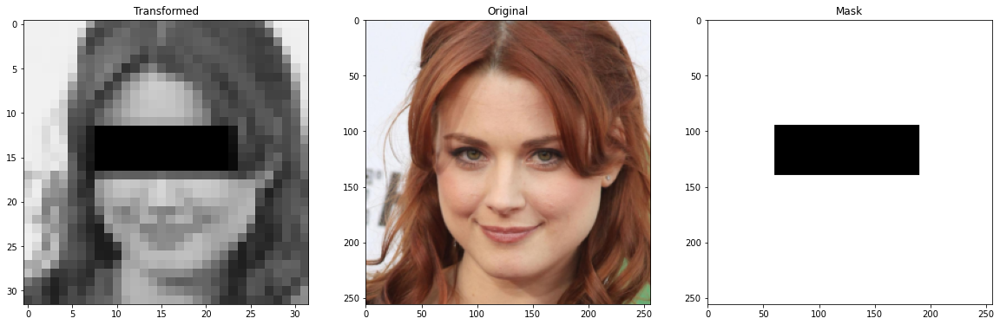

In [11]:
#Generate and save mask according to parameters defined
if generate_mask:
  x = torch.arange(mask_x_start,mask_x_end,dtype=torch.long)
  y = torch.arange(mask_y_start,mask_y_end,dtype=torch.long)
  tensor_mask = torch.ones(256,256)
  tensor_mask[y[:,None], x] = 0
  tensor_mask = tensor_mask.unsqueeze(0)

  tvu.save_image(tensor_mask, '/content/drive/MyDrive/'+mask_name+'.png') # saving the mask

#Open image and mask
predefined_images = ["balloons", "lion", "photographer", "woman", "lemons"]
if image_name in predefined_images:
  image = Image.open("/content/images/"+image_name+".png")
else:
  image = Image.open("/content/drive/MyDrive/"+image_name+".png")

predefined_masks = ["woman_eyes", "woman_mouth", "lion_mouth", "lemons_mask"]
if task_mask or add_mask:
  if mask_name in predefined_masks:
    mask = Image.open("/content/images/"+mask_name+".png")
  else:
    mask = Image.open("/content/drive/MyDrive/"+mask_name+".png")

#Transform image into required size and into tensor
transform = Tr.Compose([
    Tr.Resize(size=(256, 256)),
    Tr.ToTensor()
])

tensor_image = transform(image)
tensor_image = tensor_image.unsqueeze(0).to(device)

#Remove transparency (fourth) channel if present
if tensor_image.shape[1] == 4:
  tensor_image = tensor_image[0][:3].unsqueeze(0)

#Transform mask into tensor
if task_mask or add_mask:
  tensor_mask = Tr.ToTensor()(mask).to(device)

#Add mask to the image
if add_mask:
  tensor_image = (tensor_image[0,:,:,:]*tensor_mask[0,:,:]).unsqueeze(0)

#Transform image in grayscale
if make_gray_image:
  tensor_image = Tr.Grayscale(3)(tensor_image)

#Reduce image resolution
if reduce_image:
  tensor_image = torch.nn.AdaptiveAvgPool2d(int(256//scale))(tensor_image)

#Showing Images
if task_mask or add_mask:
  fig, ax = plt.subplots(1, 3, figsize=(20, 20))
else:
  fig, ax = plt.subplots(1, 2, figsize=(15, 15))

ax[0].imshow(tensor_image[0].cpu().permute(1,2,0))
ax[0].set_title("Transformed")

ax[1].imshow(Tr.ToTensor()(image).cpu().permute(1,2,0))
ax[1].set_title("Original")

if task_mask or add_mask:
  ax[2].imshow(tensor_mask.cpu().permute(1,2,0))
  ax[2].set_title("Mask")

### Degradation Operator Setup:

In [12]:
########## START ##########
# The functions in this block where mostly provided in the paper (Appendix E),
# we simply changed name and performed not relevant changes to adapt them to 
# our model.

#Define A and Ap for colorization
def ACol(x):
    coef=1/3
    x = x[:,0,:,:] * coef + x[:,1,:,:]*coef + x[:,2,:,:]*coef
    return x.repeat(1,3,1,1)

def ApCol(x):
    x = x[:,0,:,:]
    return torch.stack((x, x, x), 1)

#Define A and Ap for inpainting
def AInpaint(x):
  return (x[0,:,:,:]*tensor_mask[0,:,:]).unsqueeze(0)

def ApInpaint(x):
  return AInpaint(x)

#Define A and Ap for super resolution
def ASuperRes(x):
  return torch.nn.AdaptiveAvgPool2d(int(256//scale))(x)

def ApSuperRes(x):
  n, c, h, w = x.shape
  x = torch.zeros(n,c,h,scale,w,scale).to(device) + x.view(n,c,h,1,w,1)
  return x.view(n,c,scale*h,scale*w)

########## END ##########

#Compose A and Ap with multiple tasks
def A(x):
  if task_gray:
    x = ACol(x)
  if task_mask:
    x = AInpaint(x)
  if task_sr:
    x = ASuperRes(x)
  return x

def Ap(x):
  if task_sr:
    x = ApSuperRes(x)
  if task_mask:
    x = ApInpaint(x)
  if task_gray:
    x = ApCol(x)
  return x

## Algorithms definitions

### DDNM Implementation

In [13]:
# DDNM STANDARD

# This corresponds to Algorithm 1 in the paper

def ddnm_standard():

  # setting seed for the random generator for reprodicibility purposes.
  if manual_seed: 
    torch.manual_seed(seed)

  batch_size = 1
  in_channels = 3
  image_size = 256

  with torch.no_grad():
    T = 1000 # as employed in the original DDPM paper

    # initializing random tensor from which to start
    x_T = torch.randn( 
        batch_size, in_channels, image_size, image_size,
    ).to(device)

    # initializing list for intermediate steps
    X = [x_T]

    # precomputing betas and alphas
    beta = torch.linspace(0.0001, 0.02, T) # as employed in the original DDPM paper
    alpha = 1. - beta
    alpha_cumprod = torch.cumprod(alpha, 0)

    # setting degraded image
    y = tensor_image
    
    # setup of elements when working with 'imagenet' model
    if model_name=='imagenet':
      t_one = torch.tensor([1]).to(device)

    # Sampling Loop
    for t in tqdm.tqdm(range(T,0,-1)):

      x_t = X[-1] # taking last step from list

      # intermediate computation for later
      p = 1./(alpha_cumprod[t-1].sqrt())
      q = (1. - alpha_cumprod[t-1]).sqrt()

      # calling the desired model
      if model_name=='imagenet':
        Z = model(x_t, t*t_one)
        Z = Z[:,:3]
      
      elif model_name=='celeba':
        Z = model(sample=x_t, timestep=t).sample

      x_0t = p * (x_t - Z*q) # Eq. 12 of the paper

      x_0t_hat = x_0t - Ap(A(x_0t) - y) # Eq. 13 of the paper, rearranged as explained in the report

      # intermediate computation for later, also handling index out of bounds
      n1 = alpha_cumprod[t-2].sqrt() * beta[t-1] if t > 1 else beta[t-1]
      n2 = alpha[t-1].sqrt() * (1. - alpha_cumprod[t-2]) if t > 1 else 0
      d = 1. - alpha_cumprod[t-1]

      sigma_t = ((beta[t-1] * (1. - alpha_cumprod[t-2]))/d).sqrt() if t > 1 else 0
      epsilon = torch.randn_like(x_t) if t>1 else torch.zeros_like(x_t)

      x_t_next = (n1/d)*x_0t_hat + (n2/d)*x_t + sigma_t*epsilon # Eq. 14 of the paper

      X.append(x_t_next) # adding step to list

    x_0 = X[-1] # getting final output

    return x_0

### DDNM+ with no time-travel Implementation

In [14]:
# DDNM+ with NO TIME-TRAVEL

# NOTE: this version of DDNM+ is NOT strictly shown in the paper, we still decided to
# implement it to introduce a middle step between the basic implementation and the 
# more general one, so to have a better understand of both.

# Unless otherwise stated the code and implementation choices are the same as the
# basic implementation of DDNM

def ddnm_plus():
  if manual_seed:
    torch.manual_seed(seed)

  batch_size = 1
  in_channels = 3
  image_size = 256

  with torch.no_grad():
    T = 1000
    x_T = torch.randn(
        batch_size, in_channels, image_size, image_size,
    ).to(device)

    X = [x_T]

    beta = torch.linspace(0.0001, 0.02, T)
    alpha = 1. - beta
    alpha_cumprod = torch.cumprod(alpha, 0)

    y = tensor_image
    
    if model_name=='imagenet':
      t_one = torch.tensor([1]).to(device)

    for t in tqdm.tqdm(range(T,0,-1)):
      
      x_t = X[-1]

      p = 1./(alpha_cumprod[t-1].sqrt())
      q = (1. - alpha_cumprod[t-1]).sqrt()

      if model_name=='imagenet':
        Z = model(x_t, t*t_one)
        Z = Z[:,:3]
      
      elif model_name=='celeba':
        Z = model(sample=x_t, timestep=t).sample

      n1 = alpha_cumprod[t-2].sqrt() * beta[t-1] if t > 1 else beta[t-1]
      n2 = alpha[t-1].sqrt() * (1. - alpha_cumprod[t-2]) if t > 1 else 0
      d = 1. - alpha_cumprod[t-1]

      a_t = (n1/d) # relevant value for the treshold of Eq. 19

      sigma_t = ((beta[t-1] * (1. - alpha_cumprod[t-2]))/d).sqrt() if t > 1 else 0
      epsilon = torch.randn_like(x_t) if t>1 else torch.zeros_like(x_t)

      x_0t = p * (x_t - Z*q)

      #### START ####
      # this block of code was taken directly from the paper (Appendix E),
      # and represent Eq. 19 of the paper
      if sigma_t >= a_t*sigma_y: 
          lambda_t = 1.
          gamma_t = sigma_t**2 - (a_t*lambda_t*sigma_y)**2
      else:
          lambda_t = sigma_t/(a_t*sigma_y)
          gamma_t = 0.
      #### END ####
      
      # Defining Sigma and Phi
      Sigma_t = lambda_t
      Phi_t = gamma_t

      x_0t_hat = x_0t - Sigma_t*Ap(A(x_0t) - y) # Eq. 17 of the paper

      x_t_next = (n1/d)*x_0t_hat + (n2/d)*x_t + sqrt(Phi_t)*epsilon # Derived from Eq. 18

      X.append(x_t_next)

    x_0 = X[-1]

    return x_0

### DDNM+ with time-travel Implementation

In [15]:
# DDNM+ with-TIME TRAVEL

# This corresponds to Algorithm 2 in the paper

# Unless otherwise stated the code and implementation choices are the same as the the
# basic implementation of DDNM+ with no Time Travel

def ddnm_plus_timetravel():
  if manual_seed:
    torch.manual_seed(seed)

  batch_size = 1
  in_channels = 3
  image_size = 256

  with torch.no_grad():
    T = 1000
    x_T = torch.randn(
        batch_size, in_channels, image_size, image_size,
    ).to(device)

    X = [x_T]
    
    beta = torch.linspace(0.0001, 0.02, T)
    alpha = 1. - beta
    alpha_cumprod = torch.cumprod(alpha, 0)

    y = tensor_image
    
    if model_name=='imagenet':
      t_one = torch.tensor([1]).to(device)

    for t in tqdm.tqdm(range(T,0,-1)):
      
      # L is the number of past steps to redo
      L = min(T-t, l) if t%skip==0 else 0

      # intermediate computation for later
      r = alpha_cumprod[t+L-1]/alpha_cumprod[t-1]
      mean = r.sqrt()
      variance = (1-r).sqrt()
      x_t = X[-1]
      
      # use the future to improve the past
      x_tL = mean*x_t + variance*torch.randn_like(x_t)

      X[-L-1] = x_tL

      for j in range(L, -1, -1):

        p = 1./(alpha_cumprod[t+j-1].sqrt())
        q = (1. - alpha_cumprod[t+j-1]).sqrt()

        x_tj = X[-j-1]

        if model_name=='imagenet':
          Z = model(x_tj, (t+j)*t_one)
          Z = Z[:,:3]
          
        elif model_name=='celeba':
          Z = model(sample=x_tj, timestep=(t+j)).sample

        n1 = alpha_cumprod[t+j-2].sqrt() * beta[t+j-1] if t+j>1 else beta[t+j-1]
        n2 = alpha[t+j-1].sqrt() * (1. - alpha_cumprod[t+j-2]) if t+j>1 else 0
        d = 1. - alpha_cumprod[t+j-1]

        a_tj = (n1/d)

        sigma_tj = ((beta[t+j-1] * (1. - alpha_cumprod[t+j-2]))/d).sqrt() if t+j>1 else 0
        epsilon = torch.randn_like(x_tj) if t+j>1 else torch.zeros_like(x_tj)

        x_0tj = p * (x_tj-Z*q)


        #### START ####
        # this block of code was taken directly from the paper (Appendix E)
        # and represent Eq. 19 of the paper
        if sigma_tj >= a_tj*sigma_y:
          lambda_tj = 1.
          gamma_tj = sigma_tj**2 - (a_tj*lambda_tj*sigma_y)**2
        else:
          lambda_tj = sigma_tj/(a_tj*sigma_y)
          gamma_tj = 0.
        #### END ####

        Sigma_tj = lambda_tj
        Phi_tj = gamma_tj

        x_0tj_hat = x_0tj - Sigma_tj*Ap(A(x_0tj) - y)

        x_tj_next = (n1/d)*x_0tj_hat + (n2/d)*x_tj + sqrt(Phi_tj)*epsilon

        # saved improved step or a new one
        if(j == 0):
          X.append(x_tj_next)
        else:
          X[-j] = x_tj_next

    x_0 = X[-1]

    return x_0

## Execution

###DDNM (execution time ~2mins using celeba or ~4 mins using imagenet)

100%|██████████| 1000/1000 [02:16<00:00,  7.33it/s]


Text(0.5, 1.0, 'Original image')

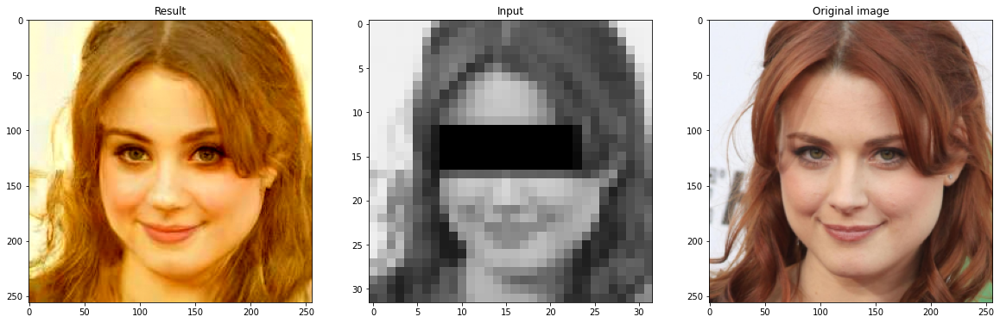

In [16]:
result_1 = ddnm_standard()[0]

#show result
fig2, ax2 = plt.subplots(1,3, figsize=(20,20))

ax2[0].imshow(result_1.cpu().permute(1,2,0))
ax2[0].set_title("Result")

ax2[1].imshow(tensor_image[0].cpu().permute(1,2,0))
ax2[1].set_title("Input")

ax2[2].imshow(Tr.ToTensor()(image).cpu().permute(1,2,0))
ax2[2].set_title("Original image")

###DDNM+ with no time-travel (execution time ~2mins using celeba or ~4 mins using imagenet)

100%|██████████| 1000/1000 [02:09<00:00,  7.75it/s]


Text(0.5, 1.0, 'Original image')

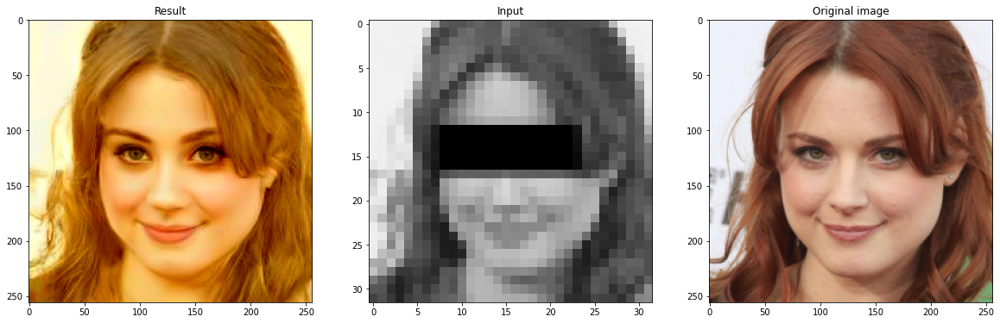

In [17]:
result_2 = ddnm_plus()[0]

#show result
fig3, ax3 = plt.subplots(1,3, figsize=(20,20))

ax3[0].imshow(result_2.cpu().permute(1,2,0))
ax3[0].set_title("Result")

ax3[1].imshow(tensor_image[0].cpu().permute(1,2,0))
ax3[1].set_title("Input")

ax3[2].imshow(Tr.ToTensor()(image).cpu().permute(1,2,0))
ax3[2].set_title("Original image")

###DDNM+ with time-travel (execution time ~$\frac{3*l}{skip}$mins using celeba or ~$\frac{6*l}{skip}$mins using imagenet)

100%|██████████| 1000/1000 [12:48<00:00,  1.30it/s]


Text(0.5, 1.0, 'Original image')

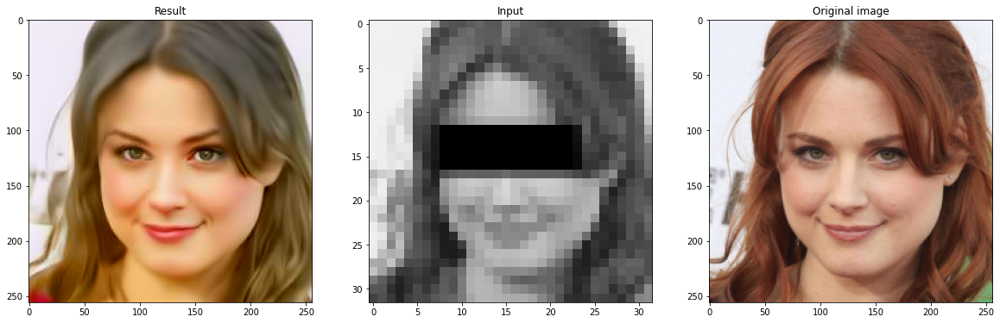

In [18]:
result_3 = ddnm_plus_timetravel()[0]

# show result
fig4, ax4 = plt.subplots(1,3, figsize=(20,20))

ax4[0].imshow(result_3.cpu().permute(1,2,0))
ax4[0].set_title("Result")

ax4[1].imshow(tensor_image[0].cpu().permute(1,2,0))
ax4[1].set_title("Input")

ax4[2].imshow(Tr.ToTensor()(image).cpu().permute(1,2,0))
ax4[2].set_title("Original image")

## Appendix A: Test generator

The code in this section was written to check that the imported model was working properly by performing image generation (its original task). The implemented equations come from the original DDPM paper: Denoising Diffusion Probabilistic Models (Ho et al., 2020).

In [ ]:
#GENERATOR

if manual_seed:
  torch.manual_seed(seed)
batch_size = 1
in_channels = 3
image_size = 256

with torch.no_grad():
  T = 1000
  x_T = torch.randn(
      batch_size, in_channels, image_size, image_size,
  ).to(device)

  X = [x_T]

  beta = torch.linspace(0.0001, 0.02, T)
  alpha = 1. - beta
  alpha_cumprod = torch.cumprod(alpha, 0)
  
  if model_name=='imagenet':
    t_one = torch.tensor([1]).to(device)

  for t in tqdm.tqdm(range(T,0,-1)):

    x_t = X[-1]

    if model_name=='imagenet':
      Z = model(x_t, t*t_one)
      Z = Z[:,:3]
    
    elif model_name=='celeba':
      Z = model(sample=x_t, timestep=t).sample

    n = 1-alpha[t-1]
    d = (1. - alpha_cumprod[t-1]).sqrt()
    q = 1 / (alpha[t-1].sqrt())

    sigma_t = ((beta[t-1] * (1. - alpha_cumprod[t-2]))/d).sqrt()
    epsilon = torch.randn_like(x_t)

    if t>1:
      x_t_next = q * (x_t - (n/d)*Z) + sigma_t*epsilon
    else:
      x_t_next = q * (x_t - (n/d)*Z)

    X.append(x_t_next)

  x_0 = X[-1]

100%|██████████| 1000/1000 [03:37<00:00,  4.59it/s]


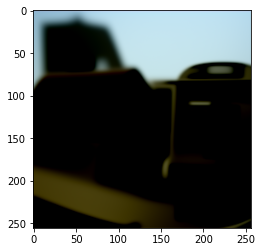

In [ ]:
#show result
plt.imshow(x_0[0].cpu().permute(1,2,0))

## Appendix B: Mask-shift trick Implementation

The mask-shift trick enables DDNM to be used with super resolution on images with bigger sizes than the ones accepted by the algorithm. It uses a trick in order to avoid having artifacts between each division of the image. In the code we are showing a demo of how it works.

In [ ]:
!mkdir "/content/images" --quiet
!wget -O "/content/images/orange.png" https://github.com/andreamazzitelli/ProjectNN/blob/main/images/orange.png?raw=true --quiet

mkdir: unrecognized option '--quiet'
Try 'mkdir --help' for more information.


In [ ]:
def ASuperRes(x):
  return torch.nn.AdaptiveAvgPool2d(64)(x)

def ApSuperRes(x):
  n, c, h, w = x.shape
  x = torch.zeros(n,c,h,4,w,4).to(device) + x.view(n,c,h,1,w,1)
  return x.view(n,c,4*h,4*w)

def ddnm(input, precomputed_left=None):
  batch_size = 1
  in_channels = 3
  image_size = 256
  with torch.no_grad():
    T = 1000
    x_T = torch.randn( 
        batch_size, in_channels, image_size, image_size,
    ).to(device)
    X = [x_T]
    beta = torch.linspace(0.0001, 0.02, T)
    alpha = 1. - beta
    alpha_cumprod = torch.cumprod(alpha, 0)
    y = input.to(device)
    if model_name=='imagenet':
      t_one = torch.tensor([1]).to(device)
    for t in tqdm.tqdm(range(T,0,-1)):
      x_t = X[-1]
      p = 1./(alpha_cumprod[t-1].sqrt())
      q = (1. - alpha_cumprod[t-1]).sqrt()
      if model_name=='imagenet':
        Z = model(x_t, t*t_one)
        Z = Z[:,:3]
      elif model_name=='celeba':
        Z = model(sample=x_t, timestep=t).sample
      x_0t = p * (x_t - Z*q)
      x_0t_hat = x_0t - ApSuperRes(ASuperRes(x_0t) - y)

      #Mask-shift trick
      if precomputed_left is not None:
        x_0t_hat_left = x_0t_hat[:,:,:,0:128]
        x_0t_hat_right = x_0t_hat[:,:,:,128:256]
        x_0t_hat = torch.cat((precomputed_left,x_0t_hat_right),3)

      n1 = alpha_cumprod[t-2].sqrt() * beta[t-1] if t > 1 else beta[t-1]
      n2 = alpha[t-1].sqrt() * (1. - alpha_cumprod[t-2]) if t > 1 else 0
      d = 1. - alpha_cumprod[t-1]
      sigma_t = ((beta[t-1] * (1. - alpha_cumprod[t-2]))/d).sqrt() if t > 1 else 0
      epsilon = torch.randn_like(x_t) if t>1 else torch.zeros_like(x_t)
      x_t_next = (n1/d)*x_0t_hat + (n2/d)*x_t + sigma_t*epsilon
      X.append(x_t_next)
    x_0 = X[-1]

    return x_0

In [ ]:
oranges = Image.open("/content/images/orange.png")
tensor_oranges = Tr.ToTensor()(oranges)
tensor_oranges_split = []
tensor_oranges_split.append(tensor_oranges[:,:,0:32])
tensor_oranges_split.append(tensor_oranges[:,:,32:64])
tensor_oranges_split.append(tensor_oranges[:,:,64:96])
tensor_oranges_split.append(tensor_oranges[:,:,96:128])
tensor_oranges_split.append(tensor_oranges[:,:,128:160])
tensor_oranges_split.append(tensor_oranges[:,:,160:192])
tensor_oranges_split.append(tensor_oranges[:,:,192:224])
tensor_oranges_split.append(tensor_oranges[:,:,224:256])

In [ ]:
result = []
input = torch.cat((tensor_oranges_split[0],tensor_oranges_split[1]),2).unsqueeze(0)
output = ddnm(input)
result.append(output[0][:,:,0:128])
result.append(output[0][:,:,128:256])

100%|██████████| 1000/1000 [03:33<00:00,  4.69it/s]


In [ ]:
for i in range(6):
  input = torch.cat((tensor_oranges_split[i+1],tensor_oranges_split[i+2]),2).unsqueeze(0)
  output = ddnm(input, result[i+1].unsqueeze(0))
  result.append(output[0][:,:,128:256])

100%|██████████| 1000/1000 [03:32<00:00,  4.70it/s]


Text(0.5, 1.0, 'Result')

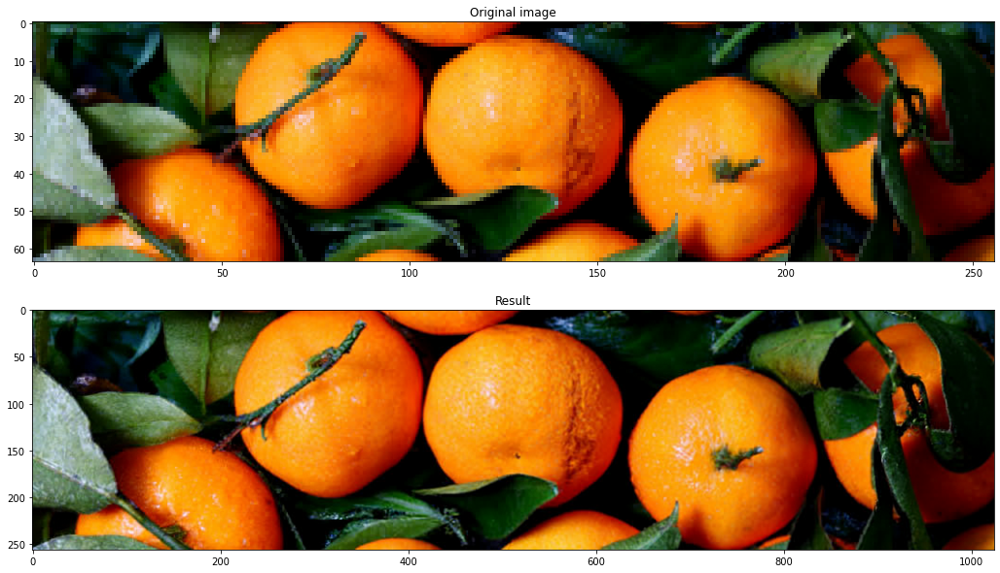

In [ ]:
sr_image = result[0]
for i in range(7):
  sr_image = torch.cat((sr_image,result[i+1]),2)
fig5, ax5 = plt.subplots(2,1, figsize=(20,10))
ax5[0].imshow(tensor_oranges.cpu().permute(1,2,0))
ax5[0].set_title("Original image")
ax5[1].imshow(sr_image.cpu().permute(1,2,0))
ax5[1].set_title("Result")

## Appendix C: Useful code for evaluation

This code can be used to compute FID (Frechet Inception Distance), PSNR (Peak Signal Noise Ratio) and SSIM (Structural Similarity Index Measure). To compute them:
- Launch the cells containing pip install and the imports
- Choose the tensors containing the generated image
- Run all the remaining cells

In [19]:
!pip install torchmetrics[image] --quiet

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 512.4/512.4 KB 30.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.8/53.8 KB 8.0 MB/s eta 0:00:00


In [20]:
from torchmetrics.image.fid import FrechetInceptionDistance
from torchmetrics import PeakSignalNoiseRatio
from torchmetrics import StructuralSimilarityIndexMeasure

In [21]:
#@title {run:"auto"}
generated = "ddnm_standard" #@param ["ddnm_standard", "ddnm_plus", "ddnm_timetravel"]
dictionary = {}
if 'result_1' in locals():
  dictionary["ddnm_standard"] = result_1
if 'result_2' in locals():
  dictionary["ddnm_plus"] = result_2
if 'result_3' in locals():
  dictionary["ddnm_timetravel"] = result_3
try:
  generated = dictionary[generated]
except:
  print("Error: Image not generated")

In [22]:
img_true = Tr.ToTensor()(image)[:3].cpu().unsqueeze(0)
img_false = generated.cpu().unsqueeze(0)

In [27]:
fid = FrechetInceptionDistance(feature=64)

fid_img_true = Tr.functional.convert_image_dtype(img_true, dtype=torch.uint8)
fid_img_false = Tr.functional.convert_image_dtype(img_false, dtype=torch.uint8)

fid.update(fid_img_true.repeat(10,1,1,1), real=True)
fid.update(fid_img_false.repeat(10,1,1,1), real=False)
print('FID: ', fid.compute().item())

FID:  87.1103515625


In [24]:
psnr = PeakSignalNoiseRatio()
print('PSNR: ', psnr(img_false, img_true).item())

PSNR:  14.867480278015137


In [25]:
ssim = StructuralSimilarityIndexMeasure()
print('SSIM: ', ssim(img_false, img_true).item())

SSIM:  0.5357064008712769


In [ ]:
#Consistency metric for colorization
y = img_true[0][0,:,:] * 1/3 + img_true[0][1,:,:]*1/3 + img_true[0][2,:,:]*1/3
Ax0 = img_false[0][0,:,:] * 1/3 + img_false[0][1,:,:]*1/3 + img_false[0][2,:,:]*1/3
print('Cons: ', torch.sum(torch.abs(Ax0-y)).item())

## Appendix D: Utilities to save images

In [ ]:
tvu.save_image(tensor_image, "/content/input.png")

In [ ]:
tvu.save_image(result_1, "/content/result_ddnm.png")
tvu.save_image(result_2, "/content/result_ddnm+.png")
tvu.save_image(result_3, "/content/result_ddnm+TT.png")

In [ ]:
tvu.save_image(tensor_oranges, "/content/original_orange.png")
tvu.save_image(sr_image, "/content/result_orange.png")

In [ ]:
tensor_image = Tr.Resize(256, Tr.InterpolationMode.NEAREST)(tensor_image)
tvu.save_image(tensor_image, "/content/input.png")

# RESULTS
In this section we are going to show some of the results we obtained. All the executions were run using a fixed seed for generating random tensors.

- DDNM denotes DDNM
- DDNM+ denotes DDNM+ without time-travel
- DDNM+TT denotes DDNM+ with time-travel

To read them more comfortably and in detail use the report in pdf.

To evaluate our implementations, we considered the same metrics used in the paper:
- Fréchet Inception Distance - FID: compares the distribution of the generated image with the ground truth one;
- Peak Signal to Noise Ratio - PSNR: measures the quality of a reconstructed signal (image in our case) compared to the original one;
- Structure Similarity Index Method - SSIM: measures the similarity between two images.
- *Consistency* metric - CONS: measures the absolute value norm of the difference between the degraded image $y$ and the result image $x_0$ to which we apply the degradation operator. ($||Ax_0-y||_1$)

We applied these metrics to the three main tasks (Colorization, Inpainting, and Super Resolution) and to their combination. Moreover, each experiment was performed both with and without denoising.

In doing these experiments, we also considered how the model influences the results. For this reason, for each pre-trained model, we selected a starting input relevant for that model. We chose the following starting images: for CelebA a woman's close-up shot, for ImageNet a lion, and a picture of some lemons (the used model is trained on a subset of the ImageNet dataset containing plants, animals, and naturally occurring objects).

Before showing the results, we should mention that, as explained in the paper [1], the *Consistency* metric has meaning only in the context of a colorization task, so we will consider it only in such cases. Moreover, PSNR and SSIM do not reflect the colorization performance. For this reason, in the experiments that involve colorization, we considered only the FID and the *Consistency* metric.

As you can see in the following tables, CelebA almost always delivers better performance when used in combination with DDNM+ with time-travel. Furthermore, the inpainting and super-resolution tasks had better results when used without any kind of noise removal, that is, using $\sigma_y=0.0$. It is worth pointing out that the image used for testing does not contain noise.

Considering the tests using ImageNet on a picture of a lion, we can see that the colorization and inpainting tasks had better results when carried out using DDNM without noise removal.

The last experiments were carried out using ImageNet on a picture of some lemons. It stands out that for the task inpainting, better results were obtained using the DDNM algorithm without time travel or denoising.

In all other cases, as you would expect, the best outcomes were achieved using DDNM+ with time-travel in combination with $\sigma_y=0.1$ for denoising.

##Woman
CelebA pre-trained model

DDNM+ with time-travel uses l=5

The mask used for the inpainting task covered the eyes

###Evaluation:

- ALL: Colorization + Inpainting + Super resolution 8x
- COL: Colorization
- INP: Inpainting
- SR: Super resolution 16x

\\

| $\sigma_y$ = 0.1 |  ALL  |  COL  |  COL  |  INP |  INP  |  INP  |  SR  |   SR  |   SR  |
|----------|:-----:|:-----:|:-----:|:----:|:-----:|:-----:|:----:|:-----:|:-----:|
| metrics  |  fid↓ |  fid↓ |  cons↓ | fid↓ | psnr↑ | ssim↑ | fid↓ | psnr↑ | ssim↑ |
| A$^\dagger$y     | 8.47  | 6.93  | 0.0 | 0.35 | 15.86 | 0.86  | 4.67 | 19.56 | 0.47  |
| DDNM     | 87.11 | 83.30 | 901.8 | 0.10 | 27.55 | 0.95  | 1.50 | 20.97 | 0.55  |
| DDNM+    | 70.79 | 70.73 | 1266 | 0.25 | 26.93 | 0.90  | 0.24 | 21.06 | 0.57  |
| DDNM+TT  | 3.93  | 1.56  | 733.7  | 0.59 | 30.32 | 0.90  | 1.26 | 22.24 | 0.60  |

\\

| $\sigma_y$ = 0.0 |  ALL  |  COL  |  COL  |  INP  |  INP  |  INP  |  SR  |   SR  |   SR  |
|------------------|:-----:|:-----:|:-----:|:-----:|:-----:|:-----:|:----:|:-----:|:-----:|
| metrics          |  fid↓ |  fid↓ | cons↓ |  fid↓ | psnr↑ | ssim↑ | fid↓ | psnr↑ | ssim↑ |
| A$^\dagger$y     | 8.47  | 6.93  |  0.0  | 0.35  | 15.86 | 0.86  | 4.67 | 19.56 | 0.47  |
| DDNM             | 87.11 | 83.30 | 901.8 | 0.10  | 27.55 | 0.95  | 1.50 | 20.97 | 0.55  |
| DDNM+            | 87.11 | 83.30 | 901.8 | 0.10  | 27.55 | 0.95  | 1.50 | 20.97 | 0.55  |
| DDNM+TT          | 4.28  | 3.31  | 137.7 | 0.004 | 31.72 | 0.96  | 0.41 | 21.96 | 0.61  |

\\

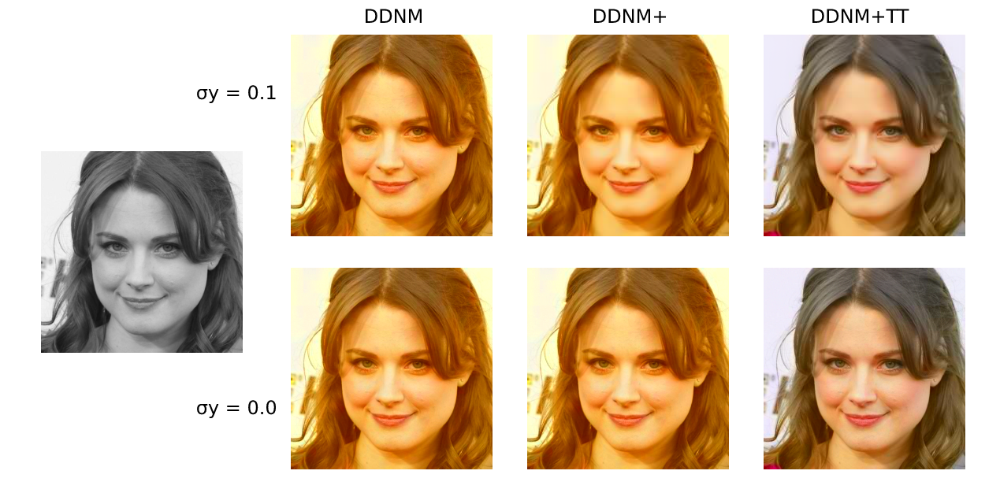

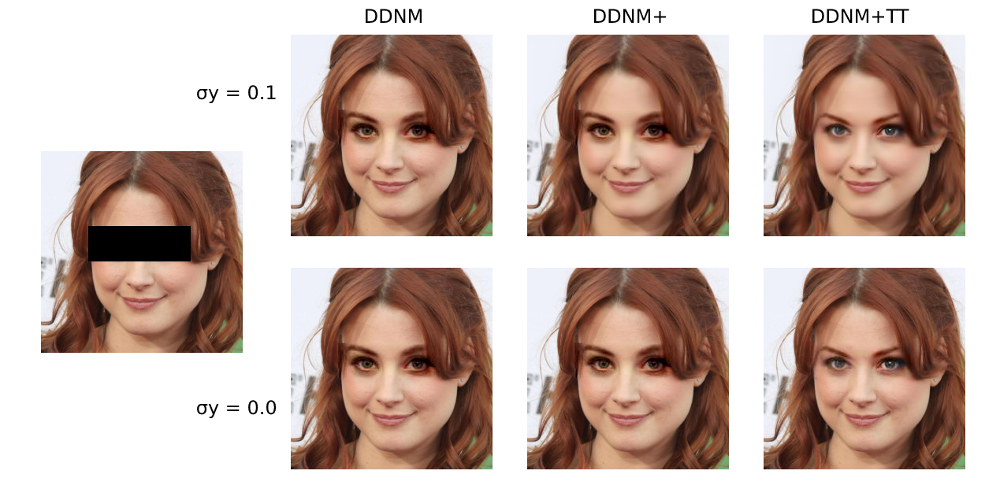

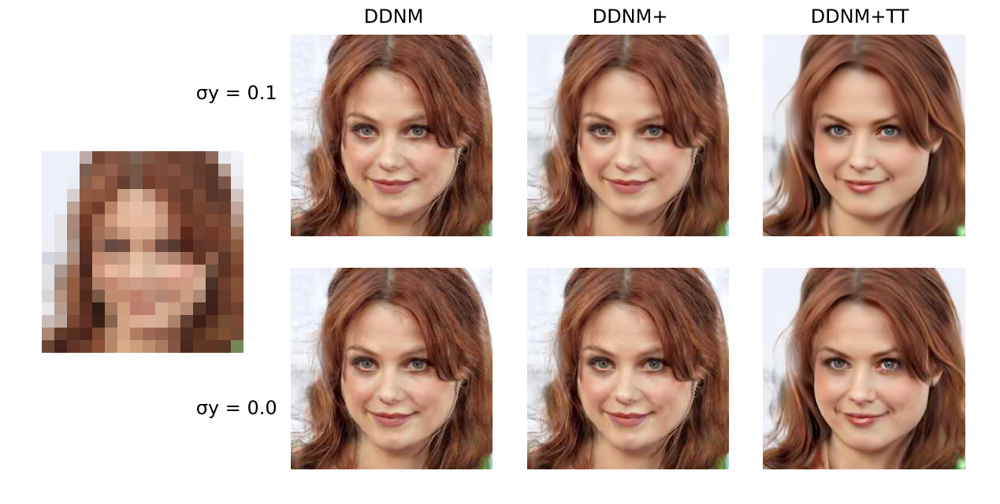

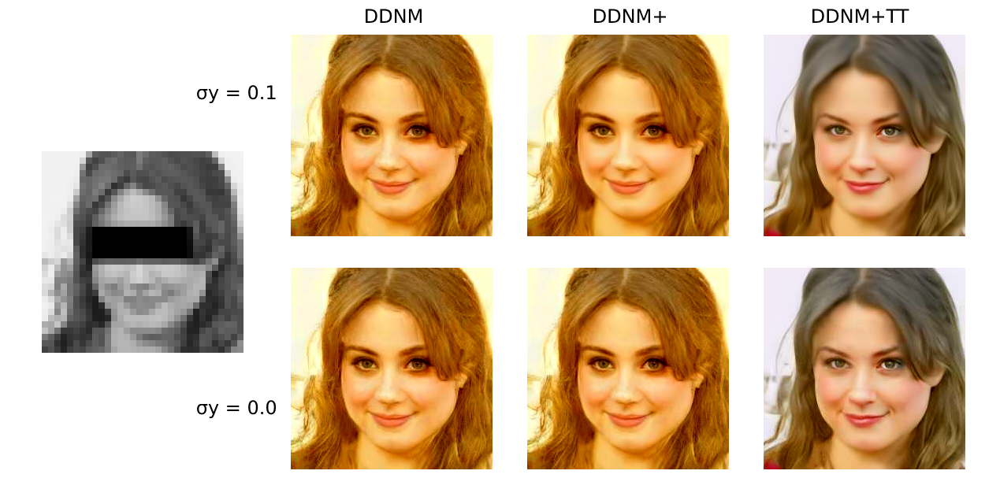

##Lion
ImageNet pre-trained model

DDNM+ with time-travel uses l=5

The mask used for the inpainting task covered the snout

###Evaluation:

- ALL: Colorization + Inpainting + Super resolution 8x
- COL: Colorization
- INP: Inpainting
- SR: Super resolution 16x

\\

| $\sigma_y$ = 0.1 |  ALL  |  COL |  COL |  INP |  INP  |  INP  |   SR  |   SR  |   SR  |
|------------------|:-----:|:----:|:----:|:----:|:-----:|:-----:|:-----:|:-----:|:-----:|
| metrics          |  fid↓ | fid↓ | cons↓ | fid↓ | psnr↑ | ssim↑ |  fid↓ | psnr↑ | ssim↑ |
| A$^\dagger$y     | 15.44 | 7.19 | 0.0  | 1.83 | 13.85 | 0.82  | 19.39 | 19.18 | 0.34  |
| DDNM             | 81.16 | 3.00 | 47.94 | 0.10 | 18.70 | 0.86  | 114.2 | 12.27 | 0.14  |
| DDNM+            | 76.78 | 2.84 | 447.9 | 0.60 | 18.70 | 0.85  | 116.3 | 12.35 | 0.15  |
| DDNM+TT          | 22.88 | 9.76 | 622.5 | 2.08 | 22.55 | 0.85  | 19.50 | 19.45 | 0.43  |

\\

| $\sigma_y$ = 0.0 |  ALL  |  COL |  COL |  INP |  INP  |  INP  |   SR  |   SR  |   SR  |
|------------------|:-----:|:----:|:----:|:----:|:-----:|:-----:|:-----:|:-----:|:-----:|
| metrics          |  fid↓ | fid↓ | cons↓ | fid↓ | psnr↑ | ssim↑ |  fid↓ | psnr↑ | ssim↑ |
| A$^\dagger$y     | 15.44 | 7.19 | 0.0  | 1.83 | 13.85 | 0.82  | 19.39 | 19.18 | 0.34  |
| DDNM             | 81.16 | 3.00 | 47.94 | 0.10 | 18.70 | 0.86  | 114.2 | 12.27 | 0.14  |
| DDNM+            | 81.16 | 3.00 | 47.94 | 0.10 | 18.70 | 0.86  | 114.2 | 12.27 | 0.14  |
| DDNM+TT          | 21.08 | 3.00 | 47.46 | 0.14 | 22.53 | 0.87  | 11.53 | 19.22 | 0.41  |

\\

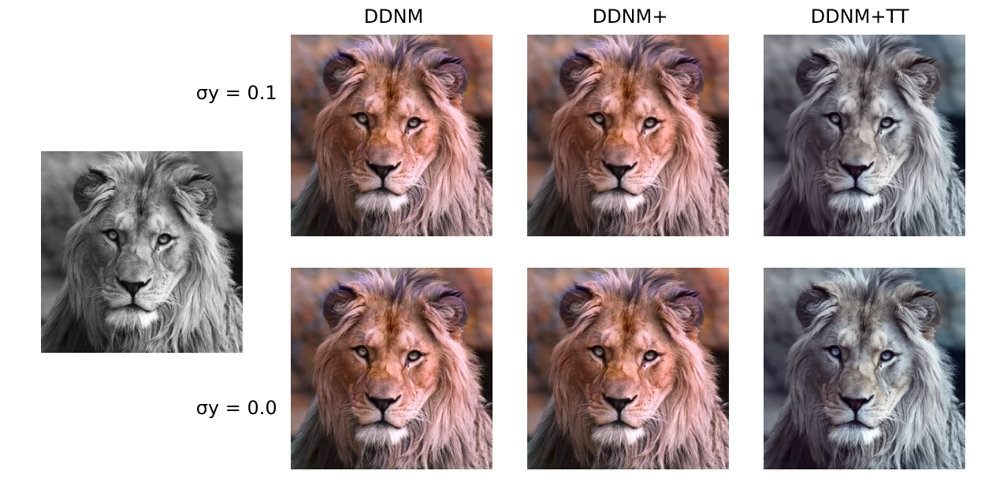

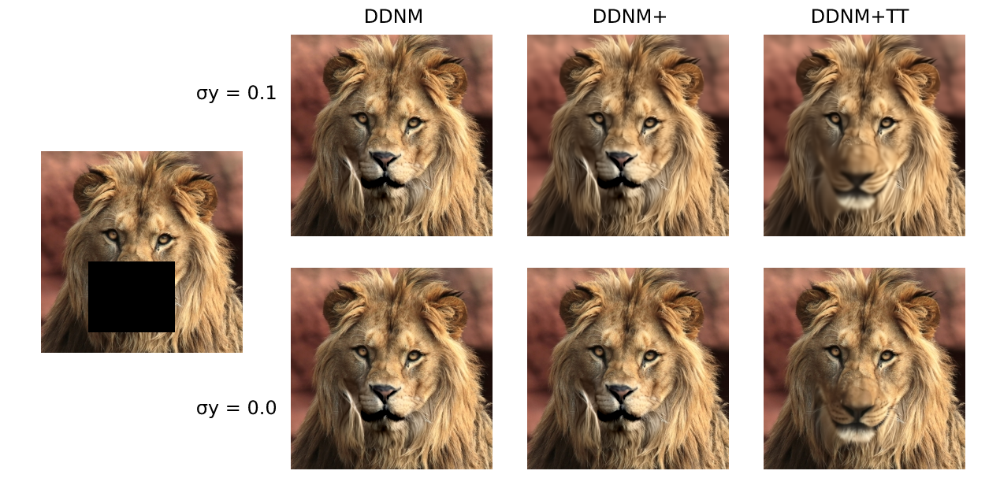

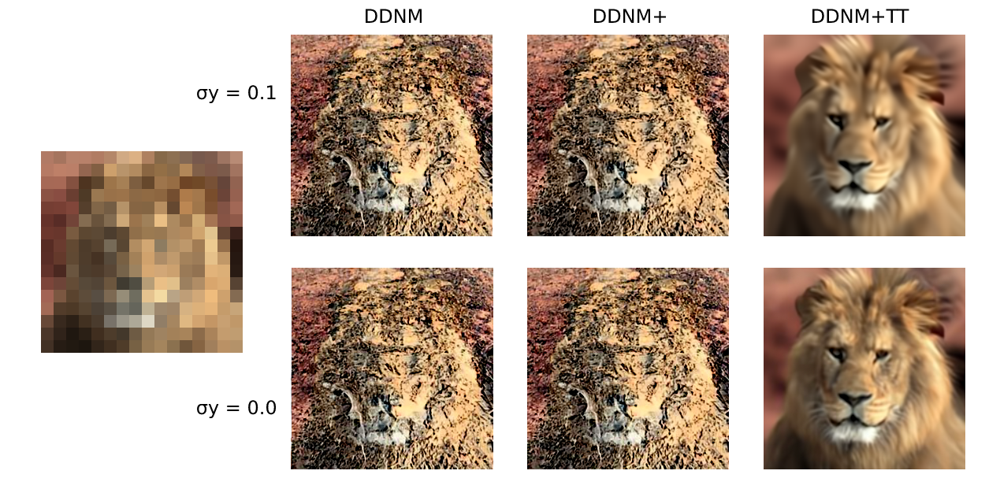

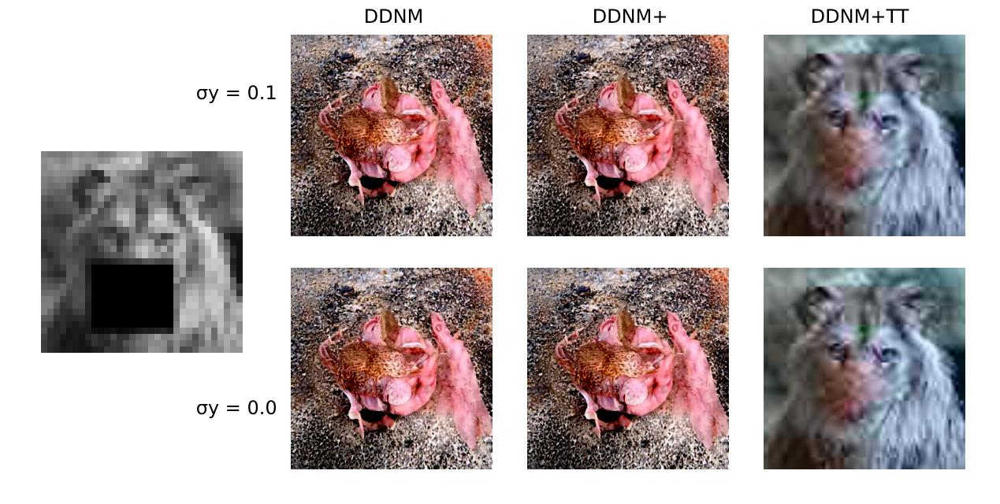

##Lemons
ImageNet pre-trained model

DDNM+ with time-travel uses l=5

The mask used for the inpainting task covered a lemon and some leaves

###Evaluation:

- ALL: Colorization + Inpainting + Super resolution 8x
- COL: Colorization
- INP: Inpainting
- SR: Super resolution 16x

\\

| $\sigma_y$ = 0.1 |  ALL  |  COL  |  COL  |  INP |  INP  |  INP  |   SR  |   SR  |   SR  |
|------------------|:-----:|:-----:|:-----:|:----:|:-----:|:-----:|:-----:|:-----:|:-----:|
| metrics          |  fid↓ |  fid↓ |  cons↓ | fid↓ | psnr↑ | ssim↑ |  fid↓ | psnr↑ | ssim↑ |
| A$^\dagger$y     | 22.85 | 21.13 | 0.0 | 0.55 | 14.41 | 0.89  | 6.68  | 19.10 | 0.47  |
| DDNM             | 24.15 | 25.11 | 65.7 | 0.03 | 25.74 | 0.94  | 42.26 | 16.66 | 0.34  |
| DDNM+            | 24.33 | 27.41 | 449.7 | 0.96 | 25.60 | 0.90  | 31.84 | 16.81 | 0.36  |
| DDNM+TT          | 22.33 | 24.38 | 528.2 | 1.90 | 25.56 | 0.89  | 2.51  | 19.90 | 0.56  |

\\

| $\sigma_y$ = 0.0 |  ALL  |  COL  |  COL  |  INP |  INP  |  INP  |   SR  |   SR  |   SR  |
|------------------|:-----:|:-----:|:-----:|:----:|:-----:|:-----:|:-----:|:-----:|:-----:|
| metrics          |  fid↓ |  fid↓ |  cons↓ | fid↓ | psnr↑ | ssim↑ |  fid↓ | psnr↑ | ssim↑ |
| A$^\dagger$y     | 22.85 | 21.13 | 0.0 | 0.55 | 14.41 | 0.89  | 6.68  | 19.10 | 0.47  |
| DDNM             | 24.15 | 25.11 | 65.7 | 0.03 | 25.74 | 0.94  | 42.26 | 16.66 | 0.34  |
| DDNM+            | 24.15 | 25.11 | 65.7 | 0.03 | 25.74 | 0.94  | 42.26 | 16.66 | 0.34  |
| DDNM+TT          | 23.80 | 22.33 | 67.44 | 0.04 | 25.73 | 0.95  | 1.81  | 19.69 | 0.52  |

\\

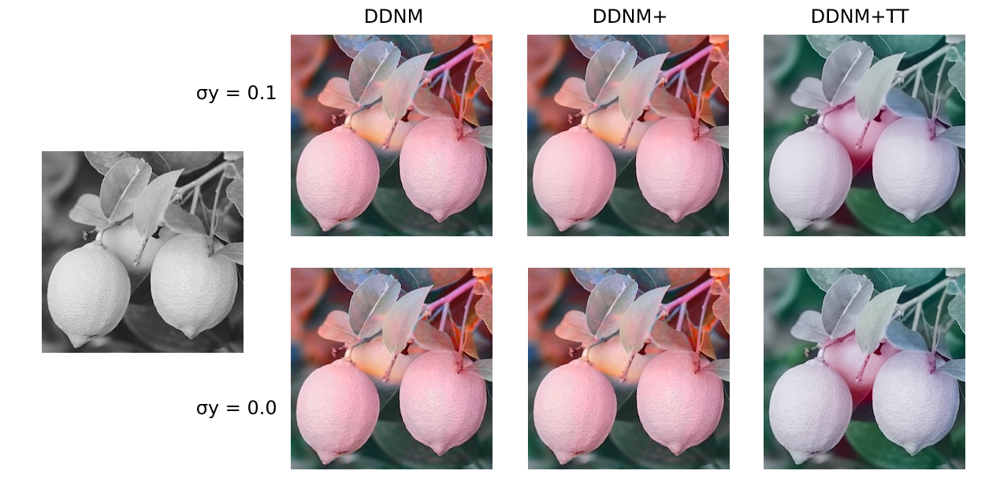

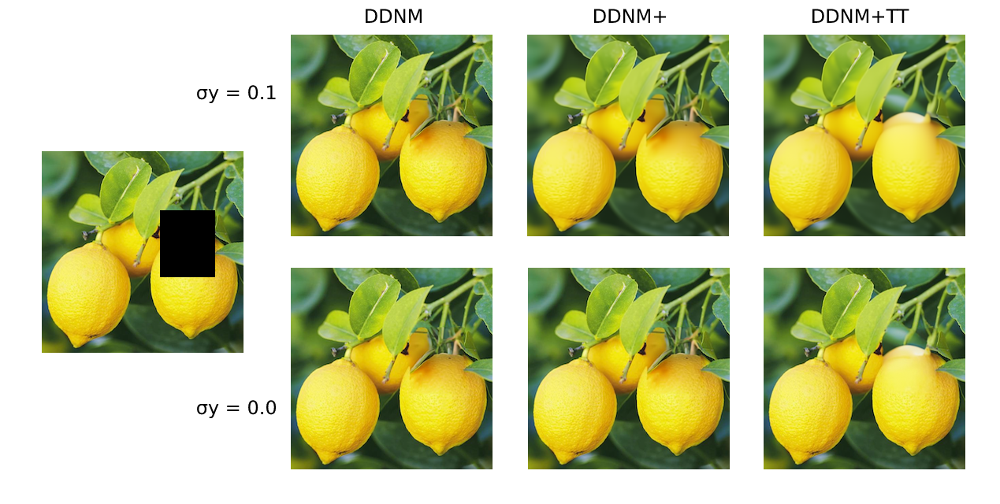

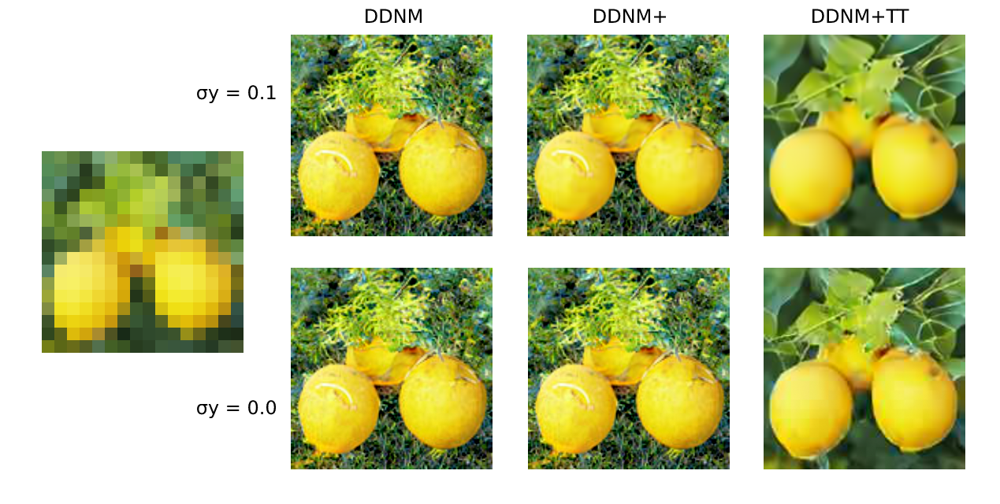

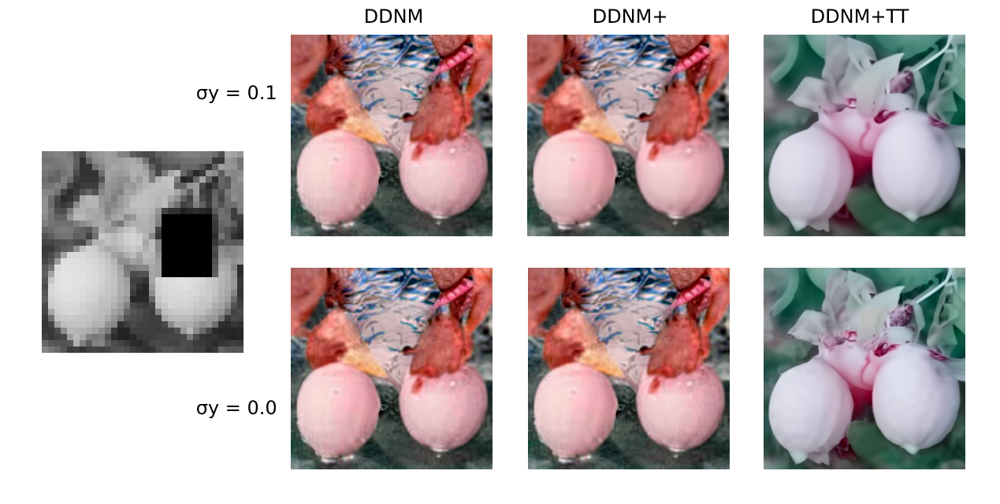

##Balloons
Denoising using DDNM+ without time-travel

ImageNet pre-trained model

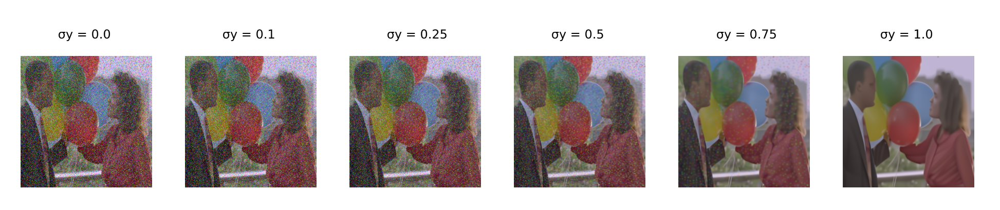

##Oranges
Mask-Shift trick using DDNM

ImageNet pre-trained model

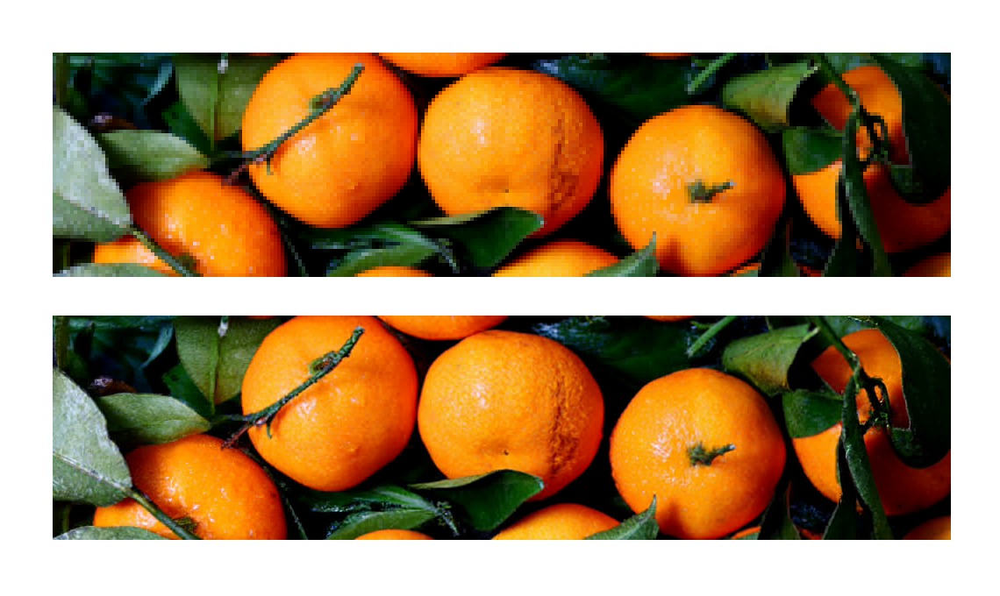

##Evolution
In this section we present the evolution of images during the model execution.

DDNM+ with time-travel using l=10 and $\sigma_y$=0.1

CelebA pre-trained model

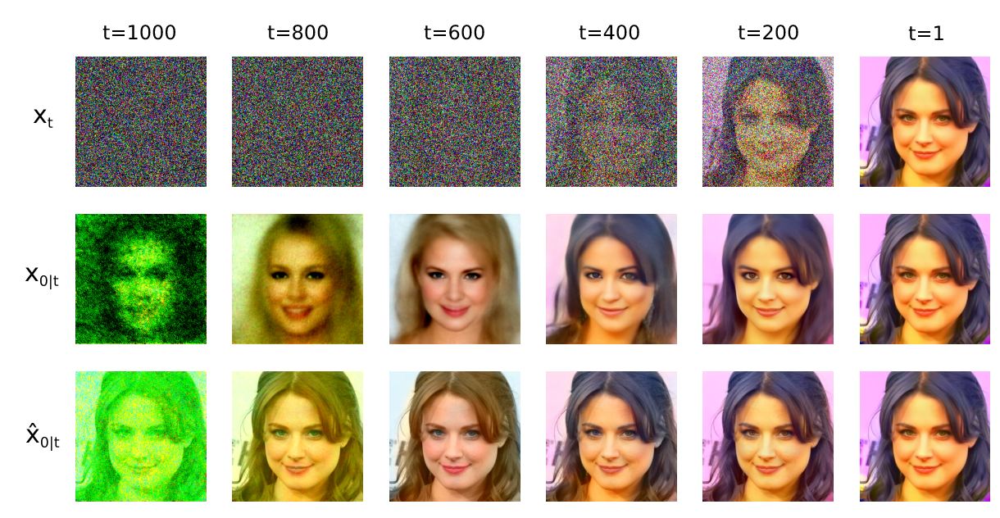

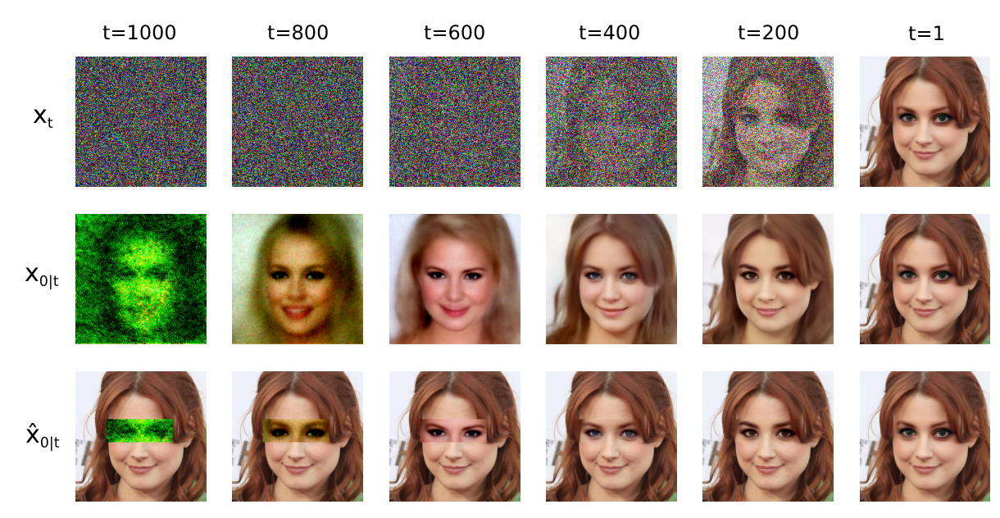

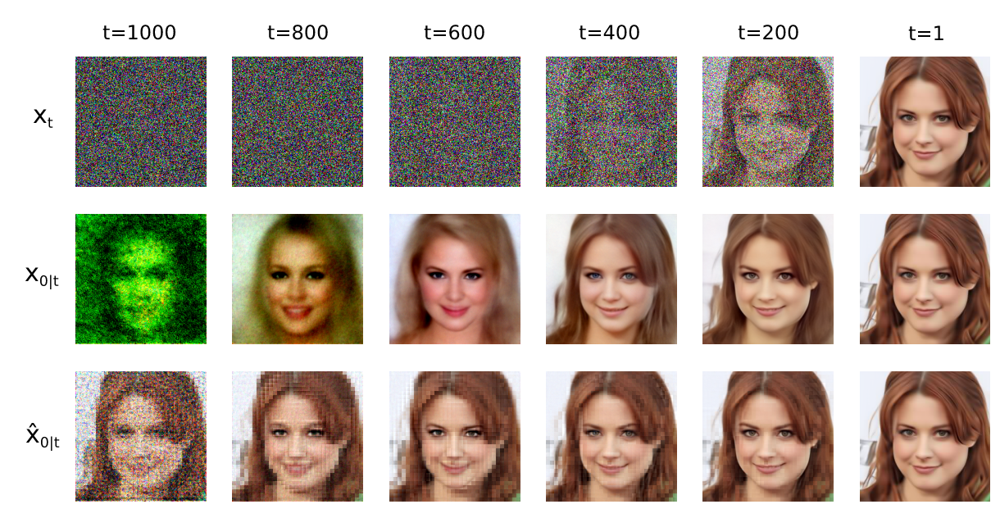

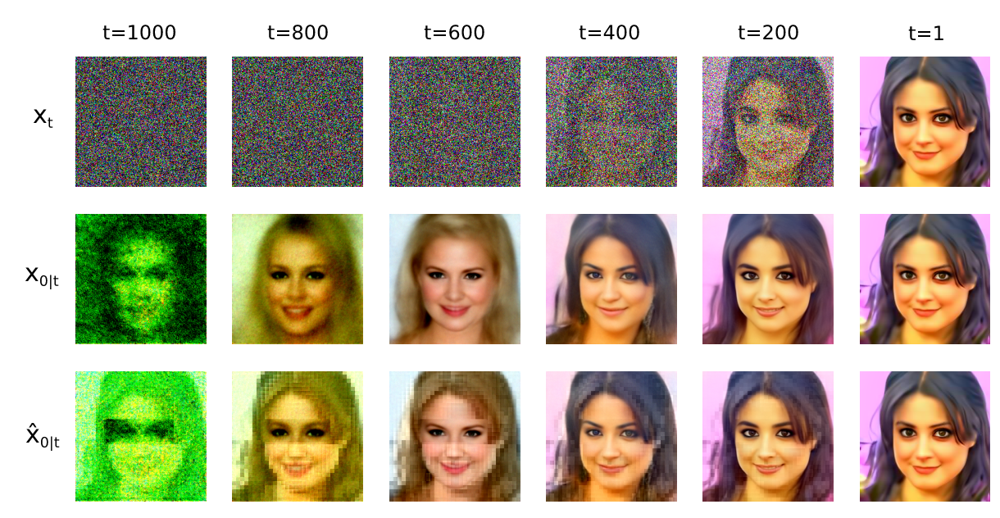

# CONCLUSIONS

This report reflects the process we went through to analyze and replicate
the chosen paper [1]. It allowed us to study in depth a state-of-the-art approach for Image Restoration and, more in general, for Image Generation. It also allows us to experiment with new technologies and learn the importance of setting the correct hyperparameters to balance between computing time and result quality. A selection of generated images can be found in the gallery that follows.

#REFERENCES

The pretrained models where downloaded from:
- ImageNet: https://github.com/openai/guided-diffusion
- CelebA: https://pypi.org/project/diffusers/

In the introduction we referenced the following papers:

- [1] Yinhuai Wang, Jiwen Yu, and Jian Zhang. Zero-Shot Image Restoration Using Denoising Diffusion Null-Space Model. 2022. arXiv: 2212.00490. url: https://arxiv.org/pdf/2212.00490.pdf
- [2] Jonathan Ho, Ajay Jain, and Pieter Abbeel. Denoising Diffusion Probabilistic Models. 2020. doi: 10.48550/ARXIV.2006.11239. url: https://arxiv.org/abs/2006.11239
- [3] Diederik P Kingma and Max Welling. Auto-Encoding Variational Bayes. 2013 (v1),
last revised 10 Dec 2022 (this version, v11). doi: 10.48550/ARXIV.1312.6114. url: https://arxiv.org/abs/1312.6114